## Imports

In [ ]:
# EXPORT
# --- Must haves ---
import os, sys
sys.path.append('..')

import torch
from torch.utils.data import Dataset, DataLoader
from torch.utils.tensorboard import SummaryWriter
import torch.cuda as cuda
import torch.nn as nn
import torchvision
import torch.nn.functional as F

from surrogates4sims.datasets import MantaFlowDataset, getSingleSim, createMantaFlowTrainTest

from surrogates4sims.utils import create_opt, create_one_cycle, find_lr, printNumModelParams, \
                                    rmse, writeMessage, plotSampleWprediction, plotSampleWpredictionByChannel, \
                                    plotSample, curl, jacobian, stream2uv, create_movie, convertSimToImage

#from surrogates4sims.models import Generator, Encoder, AE_no_P, AE_xhat_z, AE_xhat_zV2

from surrogates4sims.train import trainEpoch, validEpoch

from surrogates4sims.svd import MantaFlowSVDDataset

import numpy as np
from tqdm import tqdm
from copy import deepcopy
import matplotlib.pyplot as plt

## Settings

In [ ]:
DEBUG = False
# model name, for tensorboard recording and checkpointing purposes.
versionName = "LIN_SVD_only_p_LSTM_bidirec"

# GPU Numbers to use. Comma seprate them for multi-GPUs.
gpu_ids = "1"#,1,2,3"
versionName = versionName + '_GPUs{}'.format(gpu_ids.replace(',',''))
# path to load model weights.
pretrained_path = None

# rate at which to record metrics. (number of batches to average over when recording metrics, e.g. "every 5 batches")
tensorboard_rate = 5

# number of epochs to train. This is defined here so we can use the OneCycle LR Scheduler.
epochs = 1000

# Data Directory
dataDirec = '/data/mantaFlowSim/data/smoke_pos21_size5_f200/v'
reverseXY = False 

# checkpoint directory
cps = 'cps'
tensorboard_direc = "tb"

findLRs = True  
patience = 1

# hyper-params
seed = 1234
np.random.seed(seed)
testSplit = .1
bz = 1
numSamplesToKeep = np.infty #if not debugging
latentDim = 512
simLen = 200
simVizIndex = 0 # sim in the test set to visualize
numComponents = latentDim
if DEBUG:
    epochs = 5000
    numSamplesToKeep = 1000
    
versionName = versionName + '_latentDim{}_bz{}_epochs{}'.format(latentDim,bz,epochs)
versionName

'LIN_SVD_only_p_LSTM_bidirec_GPUs1_latentDim512_bz1_epochs1000'

### Select Personal GPUs

In [ ]:
!nvidia-smi

Tue Aug 18 22:02:33 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.56       Driver Version: 418.56       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  TITAN Xp            On   | 00000000:02:00.0 Off |                  N/A |
| 23%   20C    P8     8W / 250W |      1MiB / 12196MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  TITAN Xp            On   | 00000000:03:00.0 Off |                  N/A |
| 41%   69C    P2   155W / 250W |   1249MiB / 12196MiB |     73%      Default |
+-------------------------------+----------------------+----------------------+
|   2  T

In [ ]:
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]=gpu_ids

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Using device: cuda


In [ ]:
if device.type == 'cuda':
    print(cuda.is_available())
    print(cuda.device_count())
    print(cuda.current_device())
    print(cuda.get_device_name())

True
1
0
TITAN Xp


In [ ]:
a = torch.zeros(5, device=device.type)
!nvidia-smi

Tue Aug 18 22:02:36 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.56       Driver Version: 418.56       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  TITAN Xp            On   | 00000000:02:00.0 Off |                  N/A |
| 23%   20C    P8     9W / 250W |      1MiB / 12196MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  TITAN Xp            On   | 00000000:03:00.0 Off |                  N/A |
| 41%   69C    P2   161W / 250W |   1748MiB / 12196MiB |     82%      Default |
+-------------------------------+----------------------+----------------------+
|   2  T

## Datasets & Loaders

In [ ]:
# A = np.load('svd_out.npz')
# vh = A['arr_2']
# vh.shape
# data = []
# numComp = 512
# for idx in range(105):
#     D = getSingleSim(idx)
#     simDataset = MantaFlowDataset(D)
#     Z = []
#     P = []
#     X0, p = simDataset[0]
#     for sample in simDataset:
#         f, p = sample
#         coeffs = vh[:numComp]@f.flatten()
#         Z.append(coeffs)
#         P.append(p)
#     y = np.array(Z)
#     P = np.array(P)
#     X = (X0,P,y[0])
#     data.append((X,y[1:]))
# with open('simLatentVectors.pkl','wb') as fid:
#     pickle.dump(data,fid)    

In [ ]:
import pickle
with open('simLatentVectors.pkl','rb') as fid:
    data = pickle.load(fid)
len(data)

105

In [ ]:
data[0][0][0].shape, data[0][0][1].shape, data[0][0][2].shape, data[0][1].shape

((2, 128, 96), (200, 3), (512,), (199, 512))

In [ ]:
trainData, testData = createMantaFlowTrainTest(dataDirec,simLen,testSplit,seed)
print((len(trainData),len(testData)))

(19000, 2000)


In [ ]:
from glob import glob
d = glob(os.path.join(dataDirec,'*.npz'))
d = sorted(d)
simLen = 200
numSims = len(d)//simLen
numTestSamples = int(np.round(testSplit*numSims))
np.random.seed(seed)
perm = np.random.permutation(numSims)
testSims = perm[:numTestSamples]
trainSims = perm[numTestSamples:]
testSims, trainSims

(array([32, 57, 90, 63, 66, 79, 61, 48, 39, 62]),
 array([ 42,  88,  99,  54, 101,  40,  29,  51,  27,  35,  93,  17,  92,
          1,  77,  78,   9,  20,  72,  33,  55,  96,  71,  25,  85,   4,
         68,  10,  52,  98,   5,  84,  36,   7,  81,  64, 103,  82,  89,
         21,  18,  97,  86,  74,  91,  59,  22,  70,   6,  44,  56,   8,
         41,  16,  45,  31,  87,  13,  28,  46,  60,  14,  65,  12,  19,
          2,   3,  75,   0,  11,  67, 102,  34,  37, 100,  50, 104,  73,
         80,  69,  58,  95,  94,  43,  30,  26,  23,  49,  15,  24,  76,
         53,  38,  83,  47]))

In [ ]:
testDataset = [data[i] for i in testSims]
trainDataset = [data[i] for i in trainSims]
len(testDataset), len(trainDataset)

(10, 95)

In [ ]:
X,y = testDataset[0]

In [ ]:
X0, p, z0 = X
p.shape, z0.shape, y.shape

((200, 3), (512,), (199, 512))

In [ ]:
D = []
for X,y in testDataset:
    X0, p, z0 = X
    for i in range(1,200):
        D.append((p[1:i+1],z0,y[:i]))
len(D)
te = np.array(D)
te.shape

(1990, 3)

In [ ]:
D = []
for X,y in trainDataset:
    X0, p, z0 = X
    for i in range(1,200):
        D.append((p[1:i+1],z0,y[:i]))
len(D)
tr = np.array(D)
tr.shape

(18905, 3)

In [ ]:
a,b,c = tr[100]
a.shape, b.shape, c.shape

((101, 3), (512,), (101, 512))

In [ ]:
def collateFcn(x):
    return x

In [ ]:
trainDataLoader = DataLoader(dataset=tr, batch_size=bz, shuffle=True,collate_fn=collateFcn)
testDataLoader = DataLoader(dataset=te, batch_size=bz,collate_fn=collateFcn)

In [ ]:
X = next(iter(testDataLoader))

In [ ]:
X[0][0].shape, X[0][1].shape, X[0][2].shape

((1, 3), (512,), (1, 512))

In [ ]:
p = X[0][0] 
z0 = X[0][1]
y = X[0][2]
p.shape, z0.shape, y.shape

((1, 3), (512,), (1, 512))

In [ ]:
p = torch.tensor(p).unsqueeze(0)
z0 = torch.tensor(z0).unsqueeze(0)
y = torch.tensor(y)
p.shape, z0.shape, y.shape

(torch.Size([1, 1, 3]), torch.Size([1, 512]), torch.Size([1, 512]))

## Model

In [ ]:
inputSize = p.shape[2]
hiddenSize = z0.shape[1]
numLayers = 1
bidirectional = True
batch_first = True
#model = nn.LSTM(inputSize, hiddenSize, numLayers, batch_first=True, bidirectional=bidirectional)

In [ ]:
class LSTM(nn.Module):
    def __init__(self,inputSize=3, hiddenSize=512, numLayers=1, batch_first=True, bidirectional=False):
        super(LSTM,self).__init__()
        self.bidirectional = bidirectional
        self.lstm = nn.LSTM(inputSize, hiddenSize, numLayers, batch_first=batch_first, bidirectional=bidirectional)
        self.fc = nn.Linear(2*hiddenSize,hiddenSize)

    def forward(self,x,h0,c0):
        x,_ = self.lstm(x,(h0,c0))
        if self.bidirectional:
            x = x.squeeze()
            x = self.fc(x)
            x = x.unsqueeze(0)
        return x

In [ ]:
model = LSTM(inputSize, hiddenSize, numLayers, batch_first, bidirectional)
model

LSTM(
  (lstm): LSTM(3, 512, batch_first=True, bidirectional=True)
  (fc): Linear(in_features=1024, out_features=512, bias=True)
)

In [ ]:
h0 = z0.unsqueeze(1)
c0 = z0.unsqueeze(1)
if bidirectional:
    h0 = torch.cat([h0,h0],axis=0)
    c0 = torch.cat([c0,c0],axis=0)

h0.shape, c0.shape, p.shape

(torch.Size([2, 1, 512]), torch.Size([2, 1, 512]), torch.Size([1, 1, 3]))

In [ ]:
#output, (hn, cn) = model(dp, h0, c0)
# output, (hn, cn) = model(dp, (h0, c0))
# output.shape

In [ ]:
output = model(p, h0, c0)
output.shape

torch.Size([1, 512])

In [ ]:
if len(gpu_ids.split(',')) > 1:
    model = nn.DataParallel(model)

In [ ]:
printNumModelParams(model)

10 layers require gradients (unfrozen) out of 10 layers
2,642,432 parameters require gradients (unfrozen) out of 2,642,432 parameters


## Loss Function

In [ ]:
L = nn.MSELoss()

In [ ]:
L(output,y)

tensor(0.0007, grad_fn=<MseLossBackward>)

In [ ]:
combined_loss = L(output,y)
combined_loss.backward()

## Set LR

In [ ]:
# if findLRs and (len(gpu_ids.split(','))==1): # doesn't work for multigpu???
#     opt = create_opt(1e-7,model)
#     find_lr(model,opt,L,device,trainDataLoader)


In [ ]:
max_lr = .01
opt = torch.optim.Adam(model.parameters())
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(opt,patience=patience)

In [ ]:
versionName = versionName + '_lr{}'.format(str(max_lr))

In [ ]:
versionName

'LIN_SVD_only_p_LSTM_bidirec_GPUs1_latentDim512_bz1_epochs1000_lr0.01'

## Train

In [ ]:
def trainEpoch(myDataLoader, tensorboard_writer, model, opt, loss,
               metric, lr_scheduler, tensorboard_rate, device,
               tensorboard_recorder_step, total_steps):
    running_loss = 0.0
    running_rmse = 0.0
    total_loss = 0.0
    for i, X in enumerate(myDataLoader, start=1):

        # --- Main Training ---
        
        # gpu
        p = X[0][0] 
        z0 = X[0][1]
        y = X[0][2]
        p = torch.tensor(p).unsqueeze(0)
        z0 = torch.tensor(z0).unsqueeze(0)
        y = torch.tensor(y)
        
        p = p.to(device)
        z0 = z0.to(device)
        y = y.to(device)
        
        h0 = z0.unsqueeze(1)
        c0 = z0.unsqueeze(1)
        if bidirectional:
            h0 = torch.cat([h0,h0],axis=0)
            c0 = torch.cat([c0,c0],axis=0)

        # zero the parameter gradients
        opt.zero_grad()

        y_hat = model(p, h0, c0)
        combined_loss = loss(y_hat,y)
        combined_loss.backward()
        opt.step()
        
        # loss
        batch_loss = combined_loss.item()
        running_loss += batch_loss
        total_loss += batch_loss

        # --- Metrics Recording ---

        # metrics
        r = metric(y_hat, y)
        running_rmse += r

        # record lr change
        total_steps += 1
        tensorboard_writer.add_scalar(tag="LR", scalar_value=opt.param_groups[0]['lr'], global_step=total_steps)

        # tensorboard writes
        if (i % tensorboard_rate == 0):
            tensorboard_recorder_step += 1
            avg_running_loss = running_loss/tensorboard_rate
            avg_running_rmse = running_rmse/tensorboard_rate
            tensorboard_writer.add_scalar(tag="Loss", scalar_value=avg_running_loss, global_step=tensorboard_recorder_step)
            tensorboard_writer.add_scalar(tag=metric.__name__, scalar_value=avg_running_rmse, global_step=tensorboard_recorder_step)
            # reset running_loss for the next set of batches. (tensorboard_rate number of batches)
            running_loss = 0.0
            running_rmse = 0.0

    return total_loss/len(myDataLoader), tensorboard_recorder_step, total_steps


In [ ]:
def validEpoch(myDataLoader, tensorboard_writer, model, loss, metric,
               device, tensorboard_recorder_step):
    running_loss = 0.0
    running_rmse = 0.0
    for i, X in enumerate(myDataLoader, start=1):

        # --- Metrics Recording ---

        # gpu
        p = X[0][0] 
        z0 = X[0][1]
        y = X[0][2]
        p = torch.tensor(p).unsqueeze(0)
        z0 = torch.tensor(z0).unsqueeze(0)
        y = torch.tensor(y)
        
        p = p.to(device)
        z0 = z0.to(device)
        y = y.to(device)
        
        h0 = z0.unsqueeze(1)
        c0 = z0.unsqueeze(1)
        if bidirectional:
            h0 = torch.cat([h0,h0],axis=0)
            c0 = torch.cat([c0,c0],axis=0)
        
        #perc = len(X)/len(myDataLoader.dataset)
        perc = 1./len(myDataLoader.dataset)
        # forward, no gradient calculations
        with torch.no_grad():
            y_hat = model(p, h0, c0)

        # loss
        combined_loss = loss(y_hat,y)
        
        running_loss += perc*(combined_loss.item())

        # metrics
        r = metric(y_hat, y)
        running_rmse += perc*r

    avg_running_loss = running_loss
    avg_running_rmse = running_rmse
    tensorboard_writer.add_scalar(tag="Loss", scalar_value=avg_running_loss, global_step=tensorboard_recorder_step)
    tensorboard_writer.add_scalar(tag=metric.__name__, scalar_value=avg_running_rmse, global_step=tensorboard_recorder_step)

    return running_loss

In [ ]:
try:
    os.mkdir(cps)
except:
    print("checkpoints directory already exists :)")

checkpoints directory already exists :)


In [ ]:
# create a summary writer.
train_writer = SummaryWriter(os.path.join(tensorboard_direc, versionName,'train'))
test_writer = SummaryWriter(os.path.join(tensorboard_direc, versionName,'valid'))
tensorboard_recorder_step = 0
total_steps = 0

In [ ]:
model = model.to(device)
writeMessage('---------- Started Training ----------', versionName)
bestLoss = np.infty

for epoch in tqdm(range(1, epochs+1)):  # loop over the dataset multiple times
    
    writeMessage("--- Epoch {0}/{1} ---".format(epoch, epochs), versionName)
    
    model.train()
    trainLoss, tensorboard_recorder_step, total_steps = trainEpoch(trainDataLoader, 
                                                                   train_writer, model, opt, L,
                                                                   rmse, lr_scheduler, 
                                                                   tensorboard_rate, device,
                                                                   tensorboard_recorder_step, total_steps)
    
    writeMessage("trainLoss: {:.4e}".format(trainLoss),versionName)
    writeMessage("LR: {:.4e}".format(opt.param_groups[0]['lr']),versionName)
#     if trainLoss < bestLoss:
#         bestLoss = trainLoss
#         writeMessage("Better trainLoss: {:.4e}, Saving models...".format(bestLoss),versionName)
#         torch.save(model.state_dict(), os.path.join(cps,versionName))
        
    model.eval()
    valLoss = validEpoch(testDataLoader, test_writer, model, L, rmse, device, tensorboard_recorder_step)
    writeMessage("valLoss: {:.4e}".format(valLoss),versionName)

    #checkpoint progress
    if valLoss < bestLoss:
        bestLoss = valLoss
        writeMessage("Better valLoss: {:.4e}, Saving models...".format(bestLoss),versionName)
        torch.save(model.state_dict(), os.path.join(cps,versionName))

    lr_scheduler.step(trainLoss)
    
    if opt.param_groups[0]['lr'] < 5e-8:
        break
writeMessage('---------- Finished Training ----------', versionName)



  0%|          | 0/1000 [00:00<?, ?it/s]

---------- Started Training ----------
--- Epoch 1/1000 ---
trainLoss: 9.1194e-02
LR: 1.0000e-03




  0%|          | 1/1000 [03:27<57:39:05, 207.75s/it]

valLoss: 8.0005e-02
Better valLoss: 8.0005e-02, Saving models...
--- Epoch 2/1000 ---
trainLoss: 3.5598e-02
LR: 1.0000e-03




  0%|          | 2/1000 [07:04<58:20:47, 210.47s/it]

valLoss: 7.6026e-02
Better valLoss: 7.6026e-02, Saving models...
--- Epoch 3/1000 ---
trainLoss: 2.2663e-02
LR: 1.0000e-03




  0%|          | 3/1000 [10:33<58:09:46, 210.02s/it]

valLoss: 8.8188e-02
--- Epoch 4/1000 ---
trainLoss: 1.6906e-02
LR: 1.0000e-03




  0%|          | 4/1000 [13:56<57:31:07, 207.90s/it]

valLoss: 8.5406e-02
--- Epoch 5/1000 ---
trainLoss: 1.3008e-02
LR: 1.0000e-03




  0%|          | 5/1000 [17:26<57:38:32, 208.56s/it]

valLoss: 8.1897e-02
--- Epoch 6/1000 ---
trainLoss: 1.0868e-02
LR: 1.0000e-03




  1%|          | 6/1000 [21:15<59:14:37, 214.56s/it]

valLoss: 8.5973e-02
--- Epoch 7/1000 ---
trainLoss: 9.4716e-03
LR: 1.0000e-03




  1%|          | 7/1000 [24:48<59:06:19, 214.28s/it]

valLoss: 8.6901e-02
--- Epoch 8/1000 ---
trainLoss: 8.4316e-03
LR: 1.0000e-03




  1%|          | 8/1000 [28:12<58:08:04, 210.97s/it]

valLoss: 8.5808e-02
--- Epoch 9/1000 ---
trainLoss: 7.9312e-03
LR: 1.0000e-03




  1%|          | 9/1000 [31:55<59:06:30, 214.72s/it]

valLoss: 8.7403e-02
--- Epoch 10/1000 ---
trainLoss: 7.0409e-03
LR: 1.0000e-03




  1%|          | 10/1000 [35:30<59:05:45, 214.89s/it]

valLoss: 8.9296e-02
--- Epoch 11/1000 ---
trainLoss: 6.6245e-03
LR: 1.0000e-03




  1%|          | 11/1000 [39:09<59:21:53, 216.09s/it]

valLoss: 8.5675e-02
--- Epoch 12/1000 ---
trainLoss: 6.0761e-03
LR: 1.0000e-03




  1%|          | 12/1000 [42:48<59:33:41, 217.03s/it]

valLoss: 8.9292e-02
--- Epoch 13/1000 ---
trainLoss: 5.7341e-03
LR: 1.0000e-03




  1%|▏         | 13/1000 [46:25<59:30:30, 217.05s/it]

valLoss: 8.7752e-02
--- Epoch 14/1000 ---
trainLoss: 5.4838e-03
LR: 1.0000e-03




  1%|▏         | 14/1000 [50:03<59:30:30, 217.27s/it]

valLoss: 8.6607e-02
--- Epoch 15/1000 ---
trainLoss: 5.1156e-03
LR: 1.0000e-03




  2%|▏         | 15/1000 [53:32<58:43:18, 214.62s/it]

valLoss: 9.0409e-02
--- Epoch 16/1000 ---
trainLoss: 4.8926e-03
LR: 1.0000e-03




  2%|▏         | 16/1000 [57:04<58:30:41, 214.07s/it]

valLoss: 8.7918e-02
--- Epoch 17/1000 ---
trainLoss: 4.5782e-03
LR: 1.0000e-03




  2%|▏         | 17/1000 [1:00:41<58:40:56, 214.91s/it]

valLoss: 9.1626e-02
--- Epoch 18/1000 ---
trainLoss: 4.4149e-03
LR: 1.0000e-03




  2%|▏         | 18/1000 [1:04:04<57:39:18, 211.36s/it]

valLoss: 9.0909e-02
--- Epoch 19/1000 ---
trainLoss: 4.3503e-03
LR: 1.0000e-03




  2%|▏         | 19/1000 [1:07:35<57:33:17, 211.21s/it]

valLoss: 8.7451e-02
--- Epoch 20/1000 ---
trainLoss: 4.2548e-03
LR: 1.0000e-03




  2%|▏         | 20/1000 [1:11:09<57:43:32, 212.05s/it]

valLoss: 9.1427e-02
--- Epoch 21/1000 ---
trainLoss: 4.0870e-03
LR: 1.0000e-03




  2%|▏         | 21/1000 [1:14:46<58:02:16, 213.42s/it]

valLoss: 8.7821e-02
--- Epoch 22/1000 ---
trainLoss: 3.9680e-03
LR: 1.0000e-03




  2%|▏         | 22/1000 [1:18:26<58:32:00, 215.46s/it]

valLoss: 8.9706e-02
--- Epoch 23/1000 ---
trainLoss: 4.0554e-03
LR: 1.0000e-03




  2%|▏         | 23/1000 [1:21:50<57:31:39, 211.97s/it]

valLoss: 9.3094e-02
--- Epoch 24/1000 ---
trainLoss: 3.6677e-03
LR: 1.0000e-03




  2%|▏         | 24/1000 [1:25:17<57:04:31, 210.52s/it]

valLoss: 9.1949e-02
--- Epoch 25/1000 ---
trainLoss: 3.5892e-03
LR: 1.0000e-03




  2%|▎         | 25/1000 [1:28:36<56:06:29, 207.17s/it]

valLoss: 9.2553e-02
--- Epoch 26/1000 ---
trainLoss: 3.5075e-03
LR: 1.0000e-03




  3%|▎         | 26/1000 [1:31:56<55:26:36, 204.92s/it]

valLoss: 9.3458e-02
--- Epoch 27/1000 ---
trainLoss: 3.4859e-03
LR: 1.0000e-03




  3%|▎         | 27/1000 [1:35:28<55:58:37, 207.11s/it]

valLoss: 9.2870e-02
--- Epoch 28/1000 ---
trainLoss: 3.3014e-03
LR: 1.0000e-03




  3%|▎         | 28/1000 [1:38:55<55:55:04, 207.10s/it]

valLoss: 9.3414e-02
--- Epoch 29/1000 ---
trainLoss: 3.2316e-03
LR: 1.0000e-03




  3%|▎         | 29/1000 [1:42:29<56:24:21, 209.13s/it]

valLoss: 9.4460e-02
--- Epoch 30/1000 ---
trainLoss: 3.2016e-03
LR: 1.0000e-03




  3%|▎         | 30/1000 [1:46:03<56:42:28, 210.46s/it]

valLoss: 9.3181e-02
--- Epoch 31/1000 ---
trainLoss: 3.1067e-03
LR: 1.0000e-03




  3%|▎         | 31/1000 [1:49:24<55:55:43, 207.78s/it]

valLoss: 9.3209e-02
--- Epoch 32/1000 ---
trainLoss: 3.0228e-03
LR: 1.0000e-03




  3%|▎         | 32/1000 [1:53:06<56:59:19, 211.94s/it]

valLoss: 9.3984e-02
--- Epoch 33/1000 ---
trainLoss: 3.0016e-03
LR: 1.0000e-03




  3%|▎         | 33/1000 [1:56:32<56:28:57, 210.28s/it]

valLoss: 9.2976e-02
--- Epoch 34/1000 ---
trainLoss: 2.9169e-03
LR: 1.0000e-03




  3%|▎         | 34/1000 [2:00:08<56:49:31, 211.77s/it]

valLoss: 9.4939e-02
--- Epoch 35/1000 ---
trainLoss: 2.8662e-03
LR: 1.0000e-03




  4%|▎         | 35/1000 [2:03:55<58:01:35, 216.47s/it]

valLoss: 9.4337e-02
--- Epoch 36/1000 ---
trainLoss: 2.8195e-03
LR: 1.0000e-03




  4%|▎         | 36/1000 [2:07:26<57:30:20, 214.75s/it]

valLoss: 9.4394e-02
--- Epoch 37/1000 ---
trainLoss: 2.7630e-03
LR: 1.0000e-03




  4%|▎         | 37/1000 [2:11:06<57:53:14, 216.40s/it]

valLoss: 9.4280e-02
--- Epoch 38/1000 ---
trainLoss: 2.7332e-03
LR: 1.0000e-03




  4%|▍         | 38/1000 [2:14:28<56:37:17, 211.89s/it]

valLoss: 9.1800e-02
--- Epoch 39/1000 ---
trainLoss: 2.7315e-03
LR: 1.0000e-03




  4%|▍         | 39/1000 [2:17:56<56:17:03, 210.85s/it]

valLoss: 9.3557e-02
--- Epoch 40/1000 ---
trainLoss: 2.6983e-03
LR: 1.0000e-03




  4%|▍         | 40/1000 [2:21:38<57:05:45, 214.11s/it]

valLoss: 8.9891e-02
--- Epoch 41/1000 ---
trainLoss: 2.6397e-03
LR: 1.0000e-03




  4%|▍         | 41/1000 [2:25:08<56:45:38, 213.07s/it]

valLoss: 8.9324e-02
--- Epoch 42/1000 ---
trainLoss: 2.5902e-03
LR: 1.0000e-03




  4%|▍         | 42/1000 [2:28:43<56:49:55, 213.56s/it]

valLoss: 9.0544e-02
--- Epoch 43/1000 ---
trainLoss: 2.5499e-03
LR: 1.0000e-03




  4%|▍         | 43/1000 [2:32:04<55:43:49, 209.64s/it]

valLoss: 8.9453e-02
--- Epoch 44/1000 ---
trainLoss: 2.5124e-03
LR: 1.0000e-03




  4%|▍         | 44/1000 [2:35:40<56:12:40, 211.67s/it]

valLoss: 9.0226e-02
--- Epoch 45/1000 ---
trainLoss: 2.4871e-03
LR: 1.0000e-03




  4%|▍         | 45/1000 [2:39:17<56:35:49, 213.35s/it]

valLoss: 8.9704e-02
--- Epoch 46/1000 ---
trainLoss: 2.4500e-03
LR: 1.0000e-03




  5%|▍         | 46/1000 [2:42:42<55:51:21, 210.78s/it]

valLoss: 8.9664e-02
--- Epoch 47/1000 ---
trainLoss: 2.4125e-03
LR: 1.0000e-03




  5%|▍         | 47/1000 [2:46:15<55:58:12, 211.43s/it]

valLoss: 9.0453e-02
--- Epoch 48/1000 ---
trainLoss: 2.3968e-03
LR: 1.0000e-03




  5%|▍         | 48/1000 [2:49:41<55:28:15, 209.76s/it]

valLoss: 9.5488e-02
--- Epoch 49/1000 ---
trainLoss: 2.3581e-03
LR: 1.0000e-03




  5%|▍         | 49/1000 [2:52:50<53:46:47, 203.58s/it]

valLoss: 9.0137e-02
--- Epoch 50/1000 ---
trainLoss: 2.3846e-03
LR: 1.0000e-03




  5%|▌         | 50/1000 [2:56:30<55:02:53, 208.60s/it]

valLoss: 9.4991e-02
--- Epoch 51/1000 ---
trainLoss: 2.3187e-03
LR: 1.0000e-03




  5%|▌         | 51/1000 [2:59:54<54:37:17, 207.21s/it]

valLoss: 9.0048e-02
--- Epoch 52/1000 ---
trainLoss: nan
LR: 1.0000e-03




  5%|▌         | 52/1000 [3:03:32<55:25:55, 210.50s/it]

valLoss: nan
--- Epoch 53/1000 ---
trainLoss: nan
LR: 1.0000e-03




  5%|▌         | 53/1000 [3:07:16<56:22:48, 214.33s/it]

valLoss: nan
--- Epoch 54/1000 ---
trainLoss: nan
LR: 1.0000e-04




  5%|▌         | 54/1000 [3:10:36<55:12:19, 210.08s/it]

valLoss: nan
--- Epoch 55/1000 ---
trainLoss: nan
LR: 1.0000e-04




  6%|▌         | 55/1000 [3:14:03<54:54:07, 209.15s/it]

valLoss: nan
--- Epoch 56/1000 ---
trainLoss: nan
LR: 1.0000e-05




  6%|▌         | 56/1000 [3:17:37<55:15:02, 210.70s/it]

valLoss: nan
--- Epoch 57/1000 ---
trainLoss: nan
LR: 1.0000e-05




  6%|▌         | 57/1000 [3:20:59<54:30:40, 208.10s/it]

valLoss: nan
--- Epoch 58/1000 ---


KeyboardInterrupt: 

## Compare: Generated vs. Simulated

In [ ]:
model.load_state_dict(torch.load(os.path.join(cps,versionName)))
model = model.to(device)

In [ ]:
model.eval()

LSTM(
  (lstm): LSTM(3, 512, batch_first=True, bidirectional=True)
  (fc): Linear(in_features=1024, out_features=512, bias=True)
)

In [ ]:
X = next(iter(testDataLoader))
p = X[0][0] 
z0 = X[0][1]
y = X[0][2]
p.shape, z0.shape, y.shape

((1, 3), (512,), (1, 512))

In [ ]:
for idx, X in enumerate(testDataLoader):
    p = X[0][0] 
    z0 = X[0][1]
    y = X[0][2]
    print(p.shape, z0.shape, y.shape)
    if idx == 198:
        break

(1, 3) (512,) (1, 512)
(2, 3) (512,) (2, 512)
(3, 3) (512,) (3, 512)
(4, 3) (512,) (4, 512)
(5, 3) (512,) (5, 512)
(6, 3) (512,) (6, 512)
(7, 3) (512,) (7, 512)
(8, 3) (512,) (8, 512)
(9, 3) (512,) (9, 512)
(10, 3) (512,) (10, 512)
(11, 3) (512,) (11, 512)
(12, 3) (512,) (12, 512)
(13, 3) (512,) (13, 512)
(14, 3) (512,) (14, 512)
(15, 3) (512,) (15, 512)
(16, 3) (512,) (16, 512)
(17, 3) (512,) (17, 512)
(18, 3) (512,) (18, 512)
(19, 3) (512,) (19, 512)
(20, 3) (512,) (20, 512)
(21, 3) (512,) (21, 512)
(22, 3) (512,) (22, 512)
(23, 3) (512,) (23, 512)
(24, 3) (512,) (24, 512)
(25, 3) (512,) (25, 512)
(26, 3) (512,) (26, 512)
(27, 3) (512,) (27, 512)
(28, 3) (512,) (28, 512)
(29, 3) (512,) (29, 512)
(30, 3) (512,) (30, 512)
(31, 3) (512,) (31, 512)
(32, 3) (512,) (32, 512)
(33, 3) (512,) (33, 512)
(34, 3) (512,) (34, 512)
(35, 3) (512,) (35, 512)
(36, 3) (512,) (36, 512)
(37, 3) (512,) (37, 512)
(38, 3) (512,) (38, 512)
(39, 3) (512,) (39, 512)
(40, 3) (512,) (40, 512)
(41, 3) (512,) (41

In [ ]:
p.shape, z0.shape, y.shape

((199, 3), (512,), (199, 512))

In [ ]:
p = torch.tensor(p).unsqueeze(0)
z0 = torch.tensor(z0).unsqueeze(0)
y = torch.tensor(y).unsqueeze(0)
p = p.to(device)
z0 = z0.to(device)
h0 = z0.unsqueeze(1)
c0 = z0.unsqueeze(1)
if bidirectional:
    h0 = torch.cat([h0,h0],axis=0)
    c0 = torch.cat([c0,c0],axis=0)
h0.shape, c0.shape, p.shape, y.shape

(torch.Size([2, 1, 512]),
 torch.Size([2, 1, 512]),
 torch.Size([1, 199, 3]),
 torch.Size([1, 199, 512]))

In [ ]:
batch_out = model(p, h0, c0)
batch_out.shape, batch_out

(torch.Size([1, 199, 512]),
 tensor([[[-1.9485e-02, -1.1311e-01,  6.4466e-02,  ...,  3.6735e-03,
            4.5306e-03,  5.6168e-04],
          [-3.3708e-02, -5.6795e-02,  3.6639e-02,  ..., -8.5693e-04,
            1.1988e-02,  3.9354e-03],
          [-4.1006e-02,  7.0124e-03, -2.4763e-02,  ..., -8.4184e-04,
            6.6128e-03,  6.7519e-04],
          ...,
          [-8.0824e+00,  1.6367e+01, -4.9771e+00,  ..., -4.5961e-02,
            9.8804e-03, -2.2841e-02],
          [-6.6161e+00,  1.5556e+01, -3.4292e+00,  ..., -1.0343e-02,
           -1.3533e-02, -1.9776e-02],
          [-1.1675e+01,  1.9121e+01, -5.1701e+00,  ...,  3.7093e-03,
           -5.8798e-02, -4.3514e-02]]], device='cuda:0',
        grad_fn=<UnsqueezeBackward0>))

In [ ]:
h0, c0

(tensor([[[-0.0087,  0.0074, -0.0082,  ..., -0.0005,  0.0017,  0.0019]],
 
         [[-0.0087,  0.0074, -0.0082,  ..., -0.0005,  0.0017,  0.0019]]],
        device='cuda:0'),
 tensor([[[-0.0087,  0.0074, -0.0082,  ..., -0.0005,  0.0017,  0.0019]],
 
         [[-0.0087,  0.0074, -0.0082,  ..., -0.0005,  0.0017,  0.0019]]],
        device='cuda:0'))

In [ ]:
batch_out = batch_out.squeeze()
y = y.squeeze()
batch_out.shape, y.shape

(torch.Size([199, 512]), torch.Size([199, 512]))

In [ ]:
err = []
for i in range(simLen-1):
    err.append(torch.norm(y[i].detach().cpu() - batch_out[i].detach().cpu()))
err

[tensor(0.5232),
 tensor(0.4111),
 tensor(0.3973),
 tensor(0.4169),
 tensor(0.4492),
 tensor(0.4849),
 tensor(0.5216),
 tensor(0.5582),
 tensor(0.5947),
 tensor(0.6311),
 tensor(0.6660),
 tensor(0.6985),
 tensor(0.7262),
 tensor(0.7461),
 tensor(0.7572),
 tensor(0.7598),
 tensor(0.7545),
 tensor(0.7442),
 tensor(0.7331),
 tensor(0.7252),
 tensor(0.7230),
 tensor(0.7259),
 tensor(0.7314),
 tensor(0.7385),
 tensor(0.7469),
 tensor(0.7578),
 tensor(0.7717),
 tensor(0.7875),
 tensor(0.8075),
 tensor(0.8304),
 tensor(0.8550),
 tensor(0.8779),
 tensor(0.8977),
 tensor(0.9129),
 tensor(0.9251),
 tensor(0.9401),
 tensor(0.9580),
 tensor(0.9801),
 tensor(1.0061),
 tensor(1.0364),
 tensor(1.0723),
 tensor(1.1144),
 tensor(1.1599),
 tensor(1.2075),
 tensor(1.2590),
 tensor(1.3147),
 tensor(1.3769),
 tensor(1.4516),
 tensor(1.5467),
 tensor(1.6608),
 tensor(1.7825),
 tensor(1.9080),
 tensor(2.0294),
 tensor(2.1447),
 tensor(2.2519),
 tensor(2.3666),
 tensor(2.4978),
 tensor(2.6351),
 tensor(2.7702

In [ ]:
d = batch_out.detach().cpu() - y
d.shape

torch.Size([199, 512])

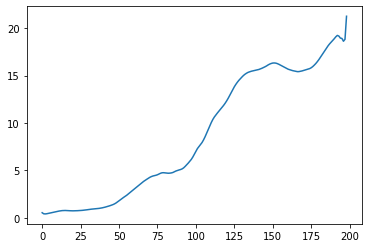

In [ ]:
import matplotlib.pyplot as plt
plt.plot(err)

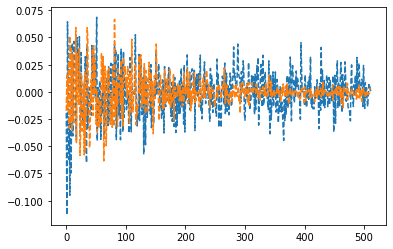

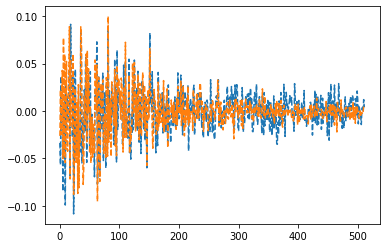

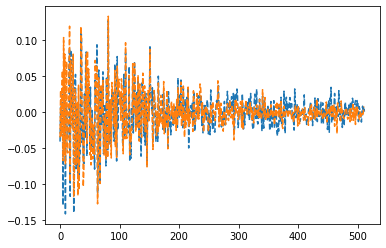

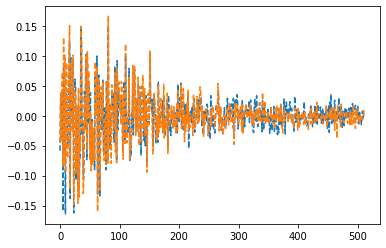

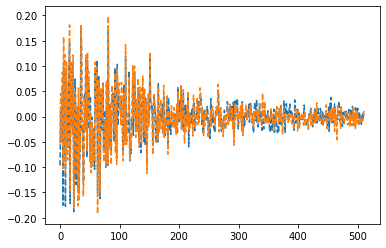

...

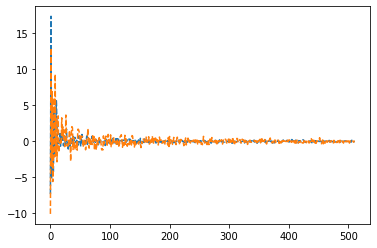

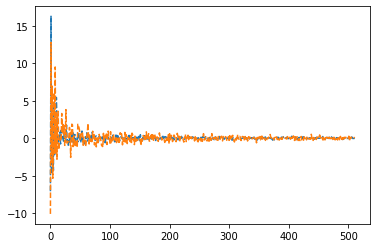

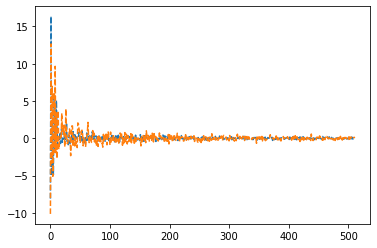

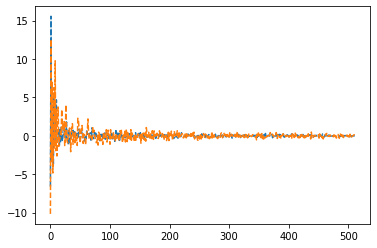

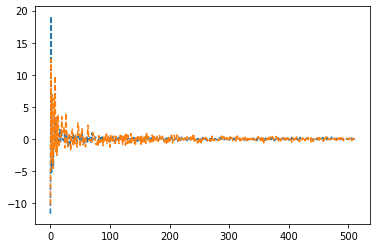

In [ ]:
t = np.arange(512)
for dd,yy in zip(batch_out,y):
    plt.plot(t, dd.detach().cpu().numpy(),'--',t, yy.detach().cpu().numpy(),'--')
    plt.show()

In [ ]:
tmp = y.detach().cpu().numpy()
tmp.max(), tmp.min()

(20.33836, -10.353894)

In [ ]:
bb = batch_out.detach().cpu().numpy()
bb.max(), bb.min()

(22.9821, -11.674571)

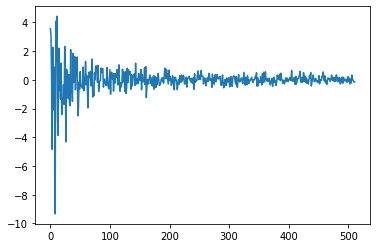

In [ ]:
plt.plot(d[-2].detach().cpu().numpy())
plt.show()

In [ ]:
from sklearn.manifold import TSNE
X = y.detach().cpu().numpy()
X.shape

(199, 512)

In [ ]:
X_embedded = TSNE(n_components=2,verbose=3).fit_transform(X)
X_embedded.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 199 samples in 0.007s...
[t-SNE] Computed neighbors for 199 samples in 0.028s...
[t-SNE] Computed conditional probabilities for sample 199 / 199
[t-SNE] Mean sigma: 5.523624
[t-SNE] Computed conditional probabilities in 0.012s
[t-SNE] Iteration 50: error = 52.0560722, gradient norm = 0.5542834 (50 iterations in 0.037s)
[t-SNE] Iteration 100: error = 51.0939751, gradient norm = 0.5557101 (50 iterations in 0.032s)
[t-SNE] Iteration 150: error = 53.0987091, gradient norm = 0.4778321 (50 iterations in 0.033s)
[t-SNE] Iteration 200: error = 51.2735786, gradient norm = 0.5279078 (50 iterations in 0.033s)
[t-SNE] Iteration 250: error = 50.6637573, gradient norm = 0.5330770 (50 iterations in 0.033s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.663757
[t-SNE] Iteration 300: error = 0.0532198, gradient norm = 0.0028372 (50 iterations in 0.030s)
[t-SNE] Iteration 350: error = 0.0462455, gradient norm = 0.0006391 (

(199, 2)

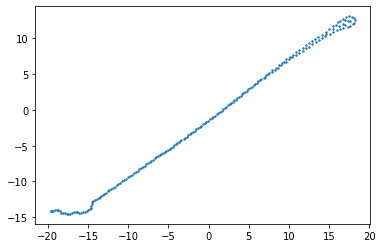

In [ ]:
plt.scatter(X_embedded[:,0],X_embedded[:,1],s=2)
plt.show()

In [ ]:
X = batch_out.detach().cpu().numpy()
X_embedded = TSNE(n_components=2,verbose=3).fit_transform(X)
X_embedded.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 199 samples in 0.007s...
[t-SNE] Computed neighbors for 199 samples in 0.027s...
[t-SNE] Computed conditional probabilities for sample 199 / 199
[t-SNE] Mean sigma: 4.333029
[t-SNE] Computed conditional probabilities in 0.012s
[t-SNE] Iteration 50: error = 52.1264610, gradient norm = 0.5282657 (50 iterations in 0.028s)
[t-SNE] Iteration 100: error = 49.7254601, gradient norm = 0.5408829 (50 iterations in 0.023s)
[t-SNE] Iteration 150: error = 50.6252060, gradient norm = 0.5021730 (50 iterations in 0.022s)
[t-SNE] Iteration 200: error = 50.5672913, gradient norm = 0.4953420 (50 iterations in 0.022s)
[t-SNE] Iteration 250: error = 48.4164085, gradient norm = 0.5623788 (50 iterations in 0.023s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.416409
[t-SNE] Iteration 300: error = 0.0842125, gradient norm = 0.0016510 (50 iterations in 0.020s)
[t-SNE] Iteration 350: error = 0.0801178, gradient norm = 0.0005285 (

(199, 2)

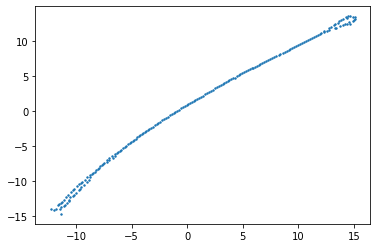

In [ ]:
plt.scatter(X_embedded[:,0],X_embedded[:,1],s=2)
plt.show()

### Visualize full simulation

Since this is using the SVD "model", we should load in the principal components and map each frame to it latentDim.

In [ ]:
testSims

array([32, 57, 90, 63, 66, 79, 61, 48, 39, 62])

In [ ]:
sim = getSingleSim(57) #  (make sure that the sim is one of the ones listed in the cell above)
len(sim)

200

In [ ]:
simDataset = MantaFlowDataset(sim)




  0%|          | 0/200 [00:00<?, ?it/s]


 30%|███       | 60/200 [00:00<00:00, 592.62it/s]


 60%|██████    | 121/200 [00:00<00:00, 595.18it/s]


100%|██████████| 200/200 [00:00<00:00, 594.79it/s]


In [ ]:
simDataLoader = DataLoader(simDataset, batch_size=200,shuffle=False)

In [ ]:
X,p = next(iter(simDataLoader))
X.shape, p.shape

(torch.Size([200, 2, 128, 96]), torch.Size([200, 3]))

In [ ]:
def reconFrame(frame,numComp=512):
    coeffs = vh[:numComp]@frame
    R = np.zeros(frame.shape)
    for idx, c in enumerate(coeffs):
        R += c*vh[idx]
    R = R.reshape(X.shape[1:])
    return R

In [ ]:
A = np.load('svd_out.npz')
vh = A['arr_2']
vh.shape

(19000, 24576)

In [ ]:
XX = X.squeeze().detach().numpy().reshape(200,24576)
XX.shape

(200, 24576)

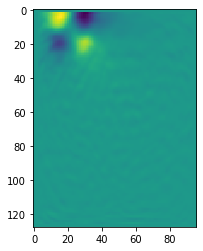

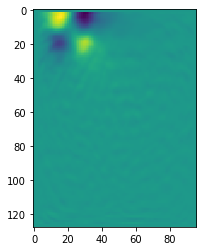

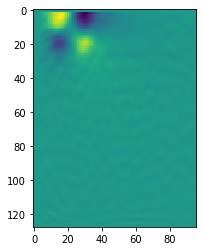

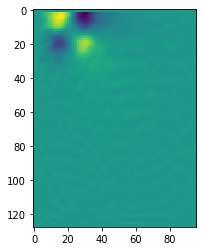

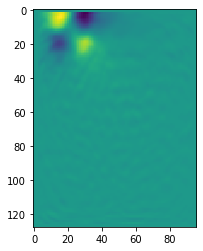

...

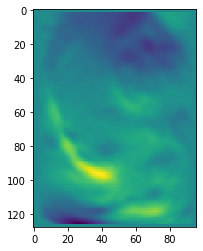

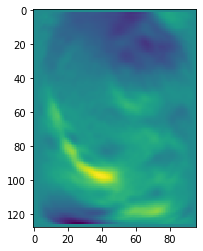

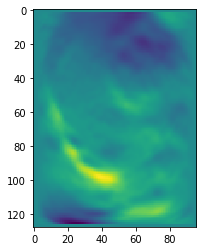

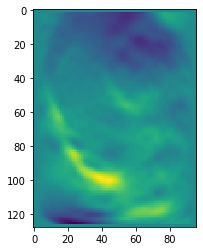

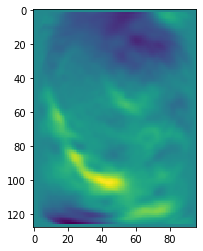

In [ ]:
for xx in XX:
    R = reconFrame(xx)
    plt.imshow(R[0])
    plt.show()

In [ ]:
## Rebuild the sequence of latent vectors based on the input conditions. 

In [ ]:
p.shape

torch.Size([200, 3])

In [ ]:
model.eval()
numComp = 512
coeffs = vh[:numComp]@XX[0] # only use the initial conditions. 
latentVecs = [coeffs]
latentVecs

[array([ 1.22078583e-02, -9.40418616e-03, -1.57924592e-02, -1.11174360e-02,
        -1.01387138e-02, -1.00162355e-02, -2.73431949e-02,  9.67078377e-04,
        -5.78729622e-03, -2.24270932e-02, -3.18429992e-03,  1.59069393e-02,
         1.88026223e-02,  2.55323201e-02, -3.95364454e-03, -1.69645511e-02,
        -6.79244800e-03, -2.31354940e-03,  2.46679895e-02, -2.10774168e-02,
        -4.49222280e-03, -2.85391882e-02, -9.82817914e-03,  1.32432757e-02,
        -1.69880930e-02,  1.66014419e-04,  3.62844579e-02, -6.68496359e-03,
         8.71775951e-03, -1.45857958e-02, -2.36310512e-02,  8.40788824e-04,
         7.25393766e-04, -1.07264463e-02,  1.33808693e-02, -2.93750297e-02,
        -2.20203418e-02,  4.87342896e-03, -9.14784987e-03, -1.66317876e-02,
        -2.17088219e-03,  2.19666287e-02, -3.75172868e-03,  1.86065696e-02,
        -8.26875586e-03, -2.86175054e-03, -3.24569759e-03, -3.92874843e-03,
         1.02916332e-02,  2.16397308e-02,  9.87909269e-03,  3.17747630e-02,
         2.0

In [ ]:
for i, pp in enumerate(p[1:],start=1):
    pp = torch.tensor(pp).unsqueeze(0).unsqueeze(0)
    z0 = torch.tensor(latentVecs[i-1]).unsqueeze(0)
    pp = pp.to(device)
    z0 = z0.to(device)
        
    h0 = z0.unsqueeze(1)
    c0 = z0.unsqueeze(1)
    if bidirectional:
        h0 = torch.cat([h0,h0],axis=0)
        c0 = torch.cat([c0,c0],axis=0)
    coeffs = model(pp,h0,c0).detach().cpu().numpy().squeeze()
    latentVecs.append(coeffs)

/home/widemann1/anaconda3/envs/torch2/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


In [ ]:
latentVecs

[array([ 1.22078583e-02, -9.40418616e-03, -1.57924592e-02, -1.11174360e-02,
        -1.01387138e-02, -1.00162355e-02, -2.73431949e-02,  9.67078377e-04,
        -5.78729622e-03, -2.24270932e-02, -3.18429992e-03,  1.59069393e-02,
         1.88026223e-02,  2.55323201e-02, -3.95364454e-03, -1.69645511e-02,
        -6.79244800e-03, -2.31354940e-03,  2.46679895e-02, -2.10774168e-02,
        -4.49222280e-03, -2.85391882e-02, -9.82817914e-03,  1.32432757e-02,
        -1.69880930e-02,  1.66014419e-04,  3.62844579e-02, -6.68496359e-03,
         8.71775951e-03, -1.45857958e-02, -2.36310512e-02,  8.40788824e-04,
         7.25393766e-04, -1.07264463e-02,  1.33808693e-02, -2.93750297e-02,
        -2.20203418e-02,  4.87342896e-03, -9.14784987e-03, -1.66317876e-02,
        -2.17088219e-03,  2.19666287e-02, -3.75172868e-03,  1.86065696e-02,
        -8.26875586e-03, -2.86175054e-03, -3.24569759e-03, -3.92874843e-03,
         1.02916332e-02,  2.16397308e-02,  9.87909269e-03,  3.17747630e-02,
         2.0

In [ ]:
L = np.array(latentVecs)
L.shape

(200, 512)

In [ ]:
recon = [X[0].detach().cpu().numpy()] # we can keep the original initial conditions
for r in L[1:]:
    R = np.zeros(XX[0].shape)
    for idx, c in enumerate(r):
        R += c*vh[idx]
    R = R.reshape(X[0].shape)
    recon.append(R)
recon = np.array(recon)
recon.shape

(200, 2, 128, 96)

In [ ]:
Real_X = X.to('cpu')
Real_X_img = convertSimToImage(Real_X)
Real_X_img.shape

torch.Size([200, 3, 128, 96])

In [ ]:
Surr_X = torch.tensor(recon)
Surr_X_img = convertSimToImage(Surr_X)
Surr_X_img.shape

torch.Size([200, 3, 128, 96])

### Metrics

In [ ]:
rmse(Real_X,Surr_X)

tensor(0.3505, dtype=torch.float64)

In [ ]:
rel_error = torch.norm(Real_X - Surr_X)/torch.norm(Real_X)
rel_error

tensor(2.6207, dtype=torch.float64)

### Make Movie

In [ ]:
Xrgb = torch.cat([Real_X_img, Surr_X_img], dim=3)
Xrgb.shape

torch.Size([200, 3, 128, 192])

MovieWriter ffmpeg unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.


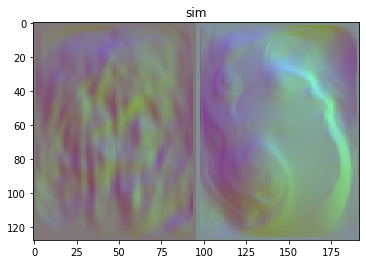

In [ ]:
outGif = '{}.gif'.format(versionName)
create_movie(Xrgb.detach().numpy(),outfile=outGif)

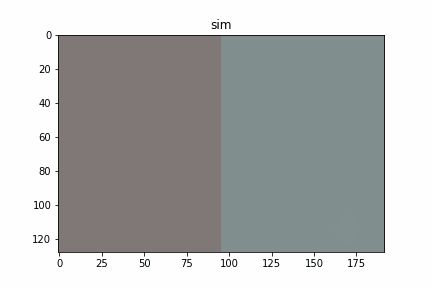

In [ ]:
from IPython.display import Image
Image(filename=outGif)